# Exploratory Data Analysis

Here we will look at the image frames captured from 

<b>Pre-requisites</b>: The notebook assumes the following

<ul>
    <li>we have ffmpeg installed on the container or host where this notebook is running. If this is running on a container then make sure the container's docker file has the following apt-get update -qq && apt-get install ffmpeg -y</li>
    <li>Similarly we have processed the video frames and stored the original images in a folder. Here we will take some of those images and run them through one of the models for object detection and then OCR to see what pre-processing techniques are likely to give us best results</li>
</ul>

In [1]:
!pip install numpy 
!pip install matplotlib
!pip uninstall -y opencv-python-headless
!pip uninstall -y opencv-python
!pip uninstall -y cv2
!pip uninstall -y pylabel
!pip install pylabel
!pip install opencv-python-headless
!pip install pytesseract
!pip install ffmpeg-python
!pip install python-Levenshtein

You should consider upgrading via the '/usr/bin/python -m pip install --upgrade pip' command.
You should consider upgrading via the '/usr/bin/python -m pip install --upgrade pip' command.
Found existing installation: opencv-python-headless 4.9.0.80
Uninstalling opencv-python-headless-4.9.0.80:
  Successfully uninstalled opencv-python-headless-4.9.0.80
Found existing installation: opencv-python 4.9.0.80
Uninstalling opencv-python-4.9.0.80:
  Successfully uninstalled opencv-python-4.9.0.80
Found existing installation: pylabel 0.1.55
Uninstalling pylabel-0.1.55:
  Successfully uninstalled pylabel-0.1.55
  Using cached pylabel-0.1.55-py3-none-any.whl (27 kB)
  Using cached opencv_python-4.9.0.80-cp37-abi3-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (62.2 MB)
You should consider upgrading via the '/usr/bin/python -m pip install --upgrade pip' command.
  Using cached opencv_python_headless-4.9.0.80-cp37-abi3-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (49.6 MB)
You should consider upgr

For the data analysis I have run my pipeline to extract images from video frames emitted via ffmpeg server using following

```
ffmpeg -i LicensePlateReaderSample_4K.mov -vcodec mpeg4 -f mpegts udp://127.0.0.1:23000
```

I have stored all the images under a <b>original</b> folder on an external volume. The images are numbered serially and I get 512 images. Over here I have taken images 25-43 to indicate that they represent the same set of vehicles but the license plate visibility goes from bad to great to again bad. They key aspect that I am exploring here is how to get the best accuracy for license plates by examining a series of images all associated with the same vehicle

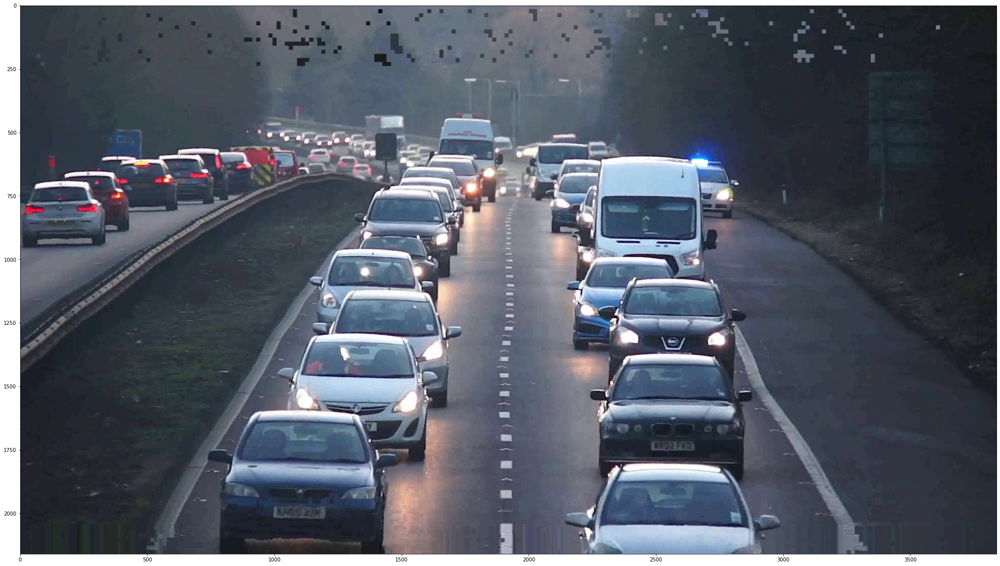

In [2]:
import numpy as np
import matplotlib.pyplot as plt 
import cv2 as cv

# Folder for excerpt of original images
original_images_folder = "original/"

# Let's display a view images to see the varying degrees of visibilities
original_img0 = cv.imread(original_images_folder + 'image25.jpeg')
original_img1 = cv.imread(original_images_folder + 'image26.jpeg')
original_img2 = cv.imread(original_images_folder + 'image33.jpeg')
original_img3 = cv.imread(original_images_folder + 'image42.jpeg')
original_img4 = cv.imread(original_images_folder + 'image49.jpeg')
original_img5 = cv.imread(original_images_folder + 'image53.jpeg')

plt.figure(figsize = (100,20))
plt.imshow(cv.cvtColor(original_img0, cv.COLOR_BGR2RGB))  

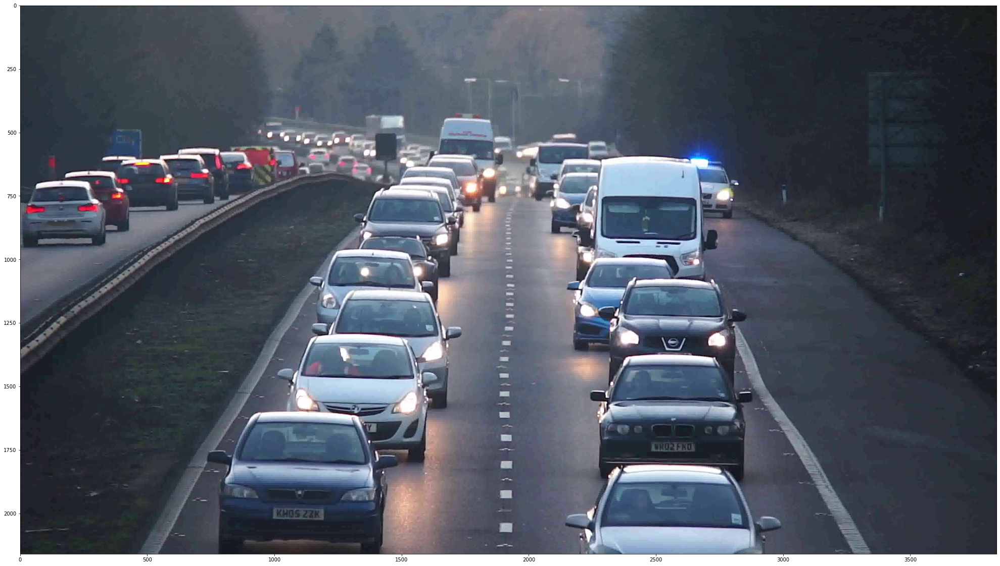

In [3]:
plt.figure(figsize = (100,20))
plt.imshow(cv.cvtColor(original_img1, cv.COLOR_BGR2RGB))

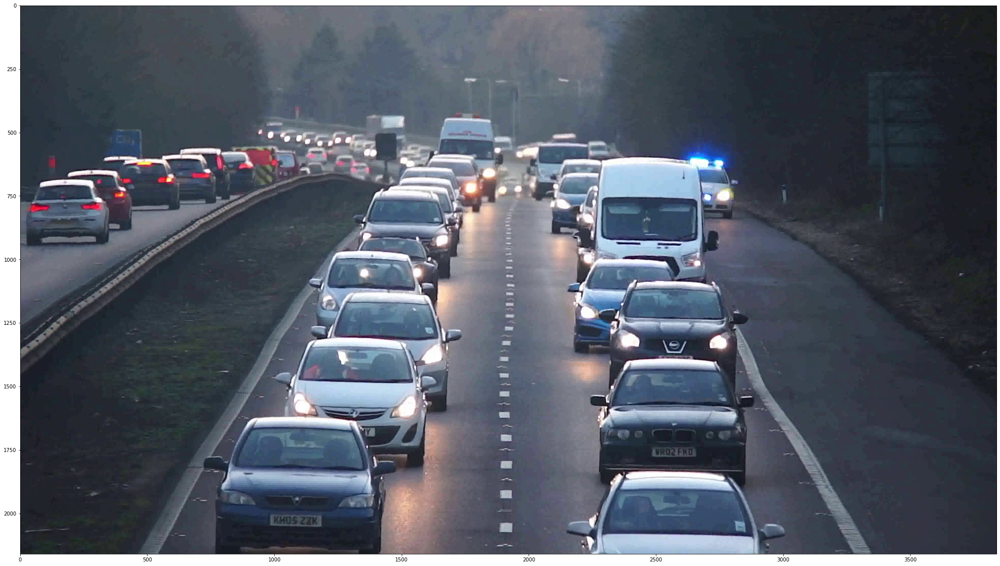

In [4]:
plt.figure(figsize = (100,20))
plt.imshow(cv.cvtColor(original_img2, cv.COLOR_BGR2RGB))

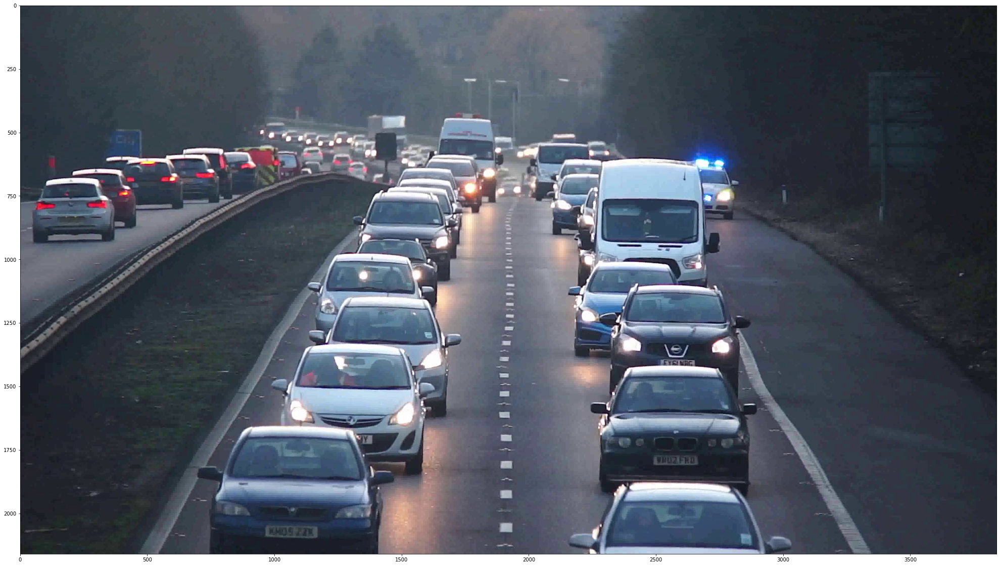

In [5]:
plt.figure(figsize = (100,20))
plt.imshow(cv.cvtColor(original_img3, cv.COLOR_BGR2RGB))

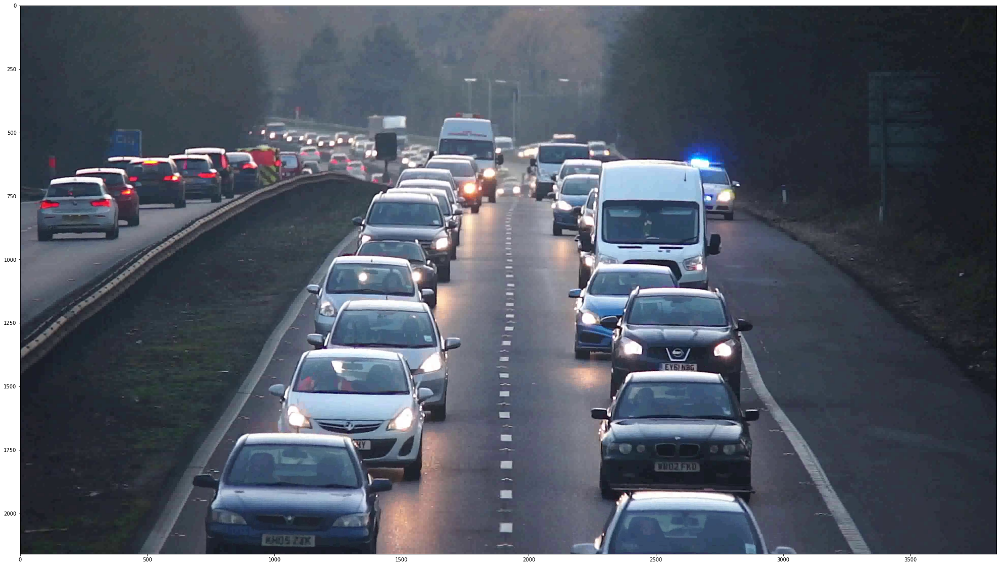

In [6]:
plt.figure(figsize = (100,20))
plt.imshow(cv.cvtColor(original_img4, cv.COLOR_BGR2RGB))

We can see from the above for the first car in the left lane, the first (image25.jpeg) and last (image43.jpeg) have license plate number blurred but the remaining ones are clear. This is to show that the camera system can capture images of varying visibilities and so the system needs to be able to leverage the best set of images to determine the plate numbers

<b>Next</b> we will crop these images to see if we get any different results with different cropping and resizing techniques. For the purpose of this I will pick <b>image32.jpeg</b>. Now we are interested in the first car on the left lane and 2nd car on the right lane. So I will crop the image to focus on these 2. 

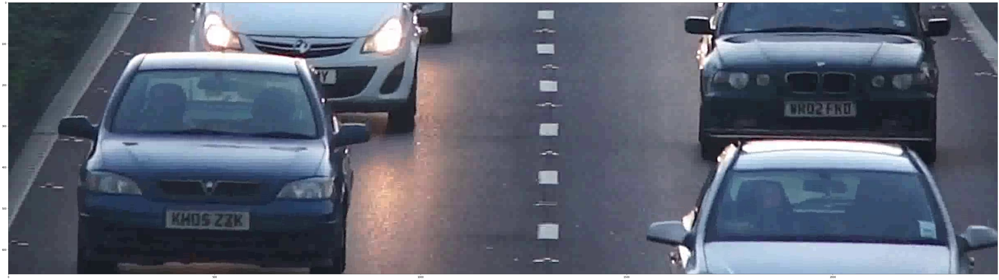

In [7]:
cropped_image1 = original_img2[1500:3000, 600:3000]
plt.figure(figsize = (100,20))
plt.imshow(cv.cvtColor(cropped_image1, cv.COLOR_BGR2RGB)) 

We can see from the above that it has got just enough of the 2 vehicles. Now let's resize it for the Yolo models

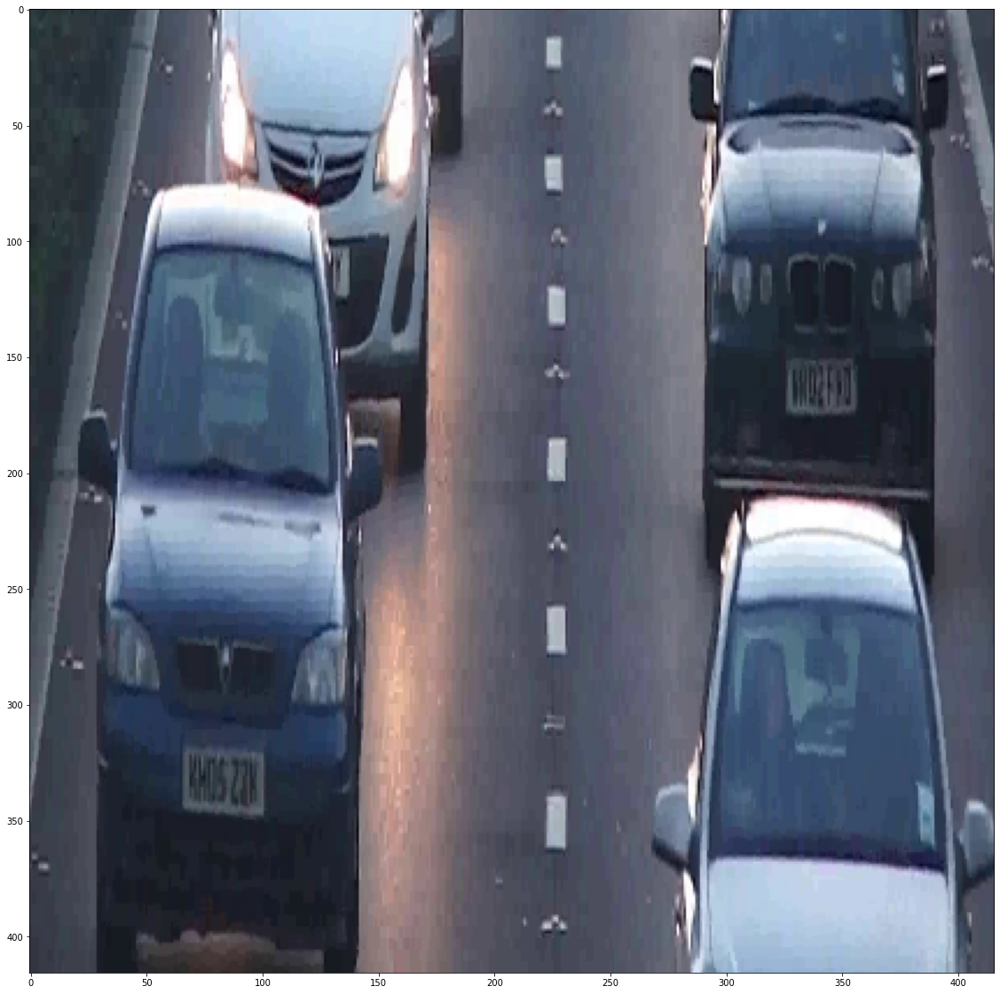

In [8]:
resized_img1 = cv.resize(cropped_image1, (416, 416)) 
plt.figure(figsize = (100,20))
plt.imshow(cv.cvtColor(resized_img1, cv.COLOR_BGR2RGB))  

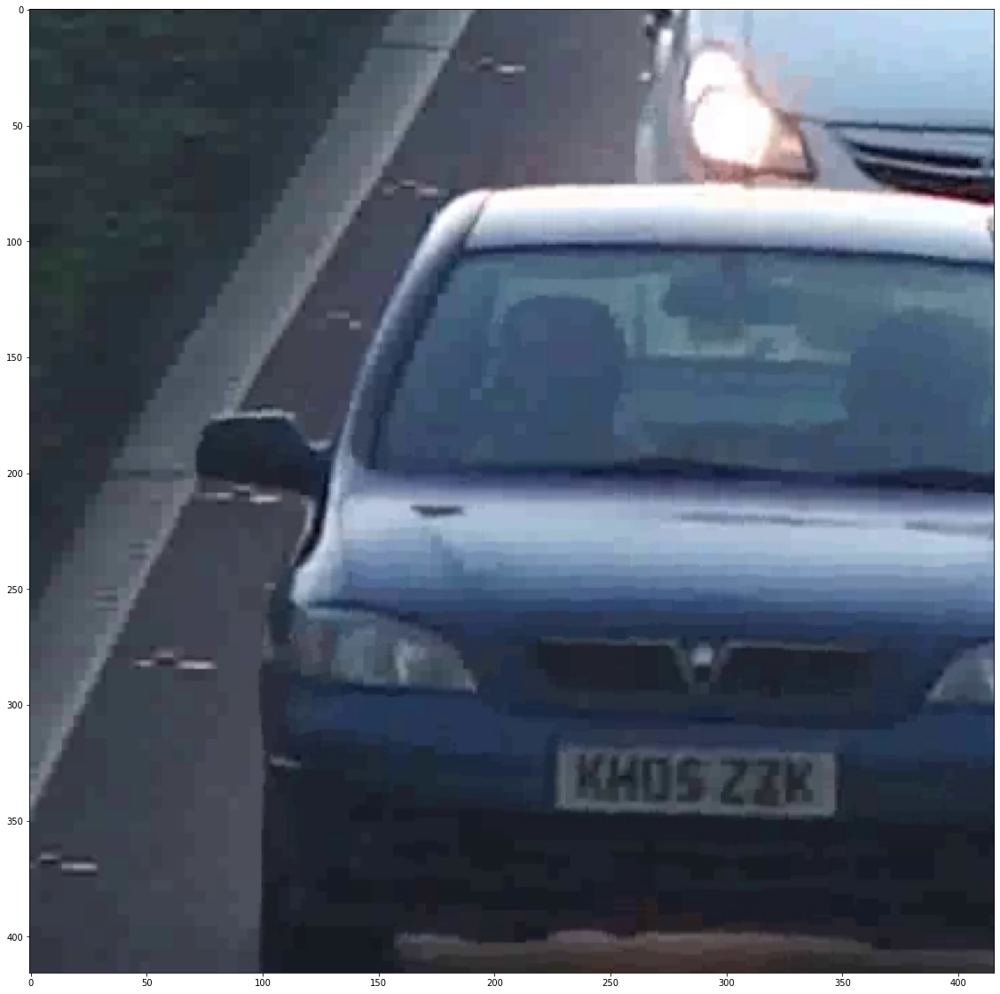

In [9]:
cropped_image2 = original_img2[1500:3000, 600:1300]
resized_img2 = cv.resize(cropped_image2, (416, 416)) 
plt.figure(figsize = (100,20))
plt.imshow(cv.cvtColor(resized_img2, cv.COLOR_BGR2RGB))  

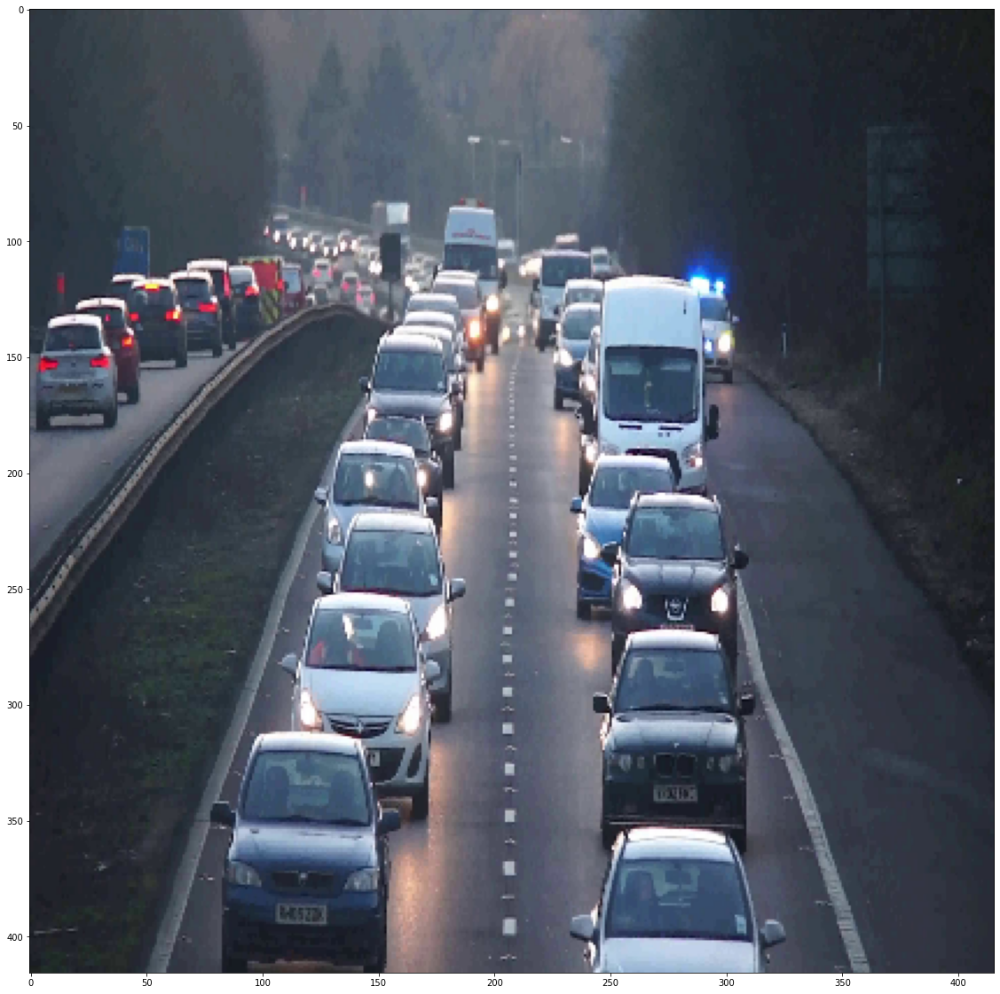

In [10]:
resized_img3 = cv.resize(original_img2, (416, 416)) 
plt.figure(figsize = (100,20))
plt.imshow(cv.cvtColor(resized_img3, cv.COLOR_BGR2RGB)) 

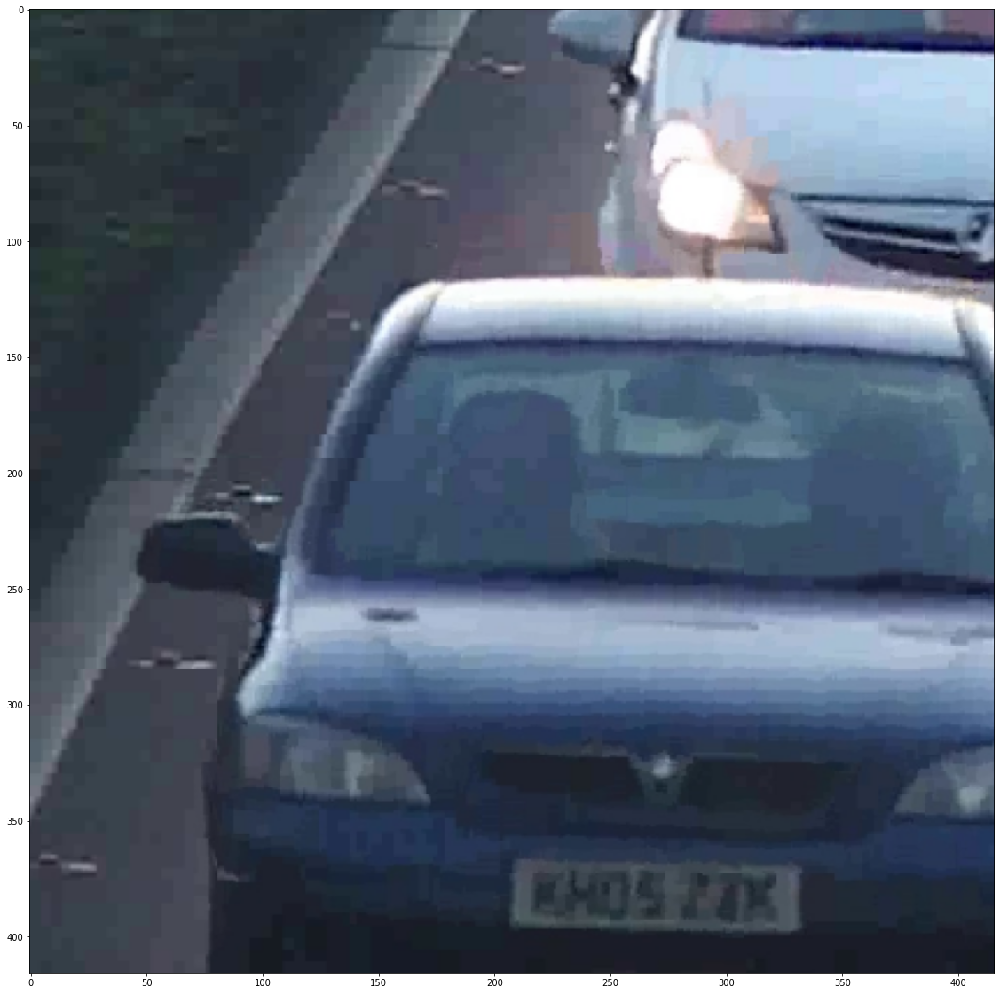

In [11]:
cropped_image4 = original_img4[1500:3000, 600:1300]
resized_img4 = cv.resize(cropped_image4, (416, 416)) 
plt.figure(figsize = (100,20))
plt.imshow(cv.cvtColor(resized_img4, cv.COLOR_BGR2RGB))  

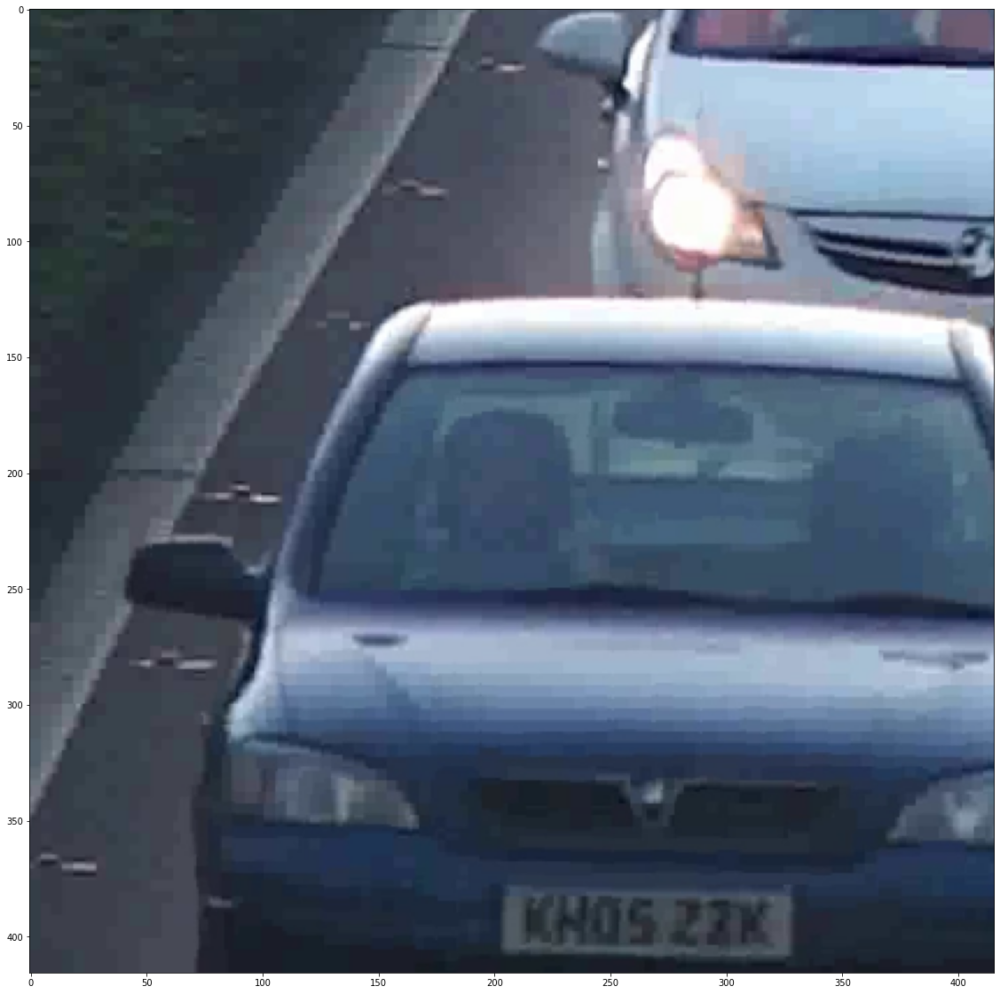

In [12]:
cropped_image5 = original_img5[1500:3000, 600:1300]
resized_img5 = cv.resize(cropped_image5, (416, 416)) 
plt.figure(figsize = (100,20))
plt.imshow(cv.cvtColor(resized_img5, cv.COLOR_BGR2RGB))  

We can see now how the image has gotten distorted where to the human eye it isn't easy to now read the license plates. We will save this image now within the cropped folder. 

In [13]:
cv.imwrite("cropped/image33_cropped.jpeg", cropped_image1)
cv.imwrite("cropped/image33_cropped_resized.jpeg", resized_img1)
cv.imwrite("cropped/image33_cropped2.jpeg", cropped_image2)
cv.imwrite("cropped/image33_cropped_resized2.jpeg", resized_img2)
cv.imwrite("cropped/image49_cropped.jpeg", cropped_image4)
cv.imwrite("cropped/image49_cropped_resized.jpeg", resized_img4)
cv.imwrite("cropped/image53_cropped.jpeg", cropped_image5)
cv.imwrite("cropped/image53_cropped_resized.jpeg", resized_img5)

True

In [14]:
# Set up the notebook to import modules from relative paths
import os, sys

#'/home/user/example/parent/child'
current_path = os.path.abspath('.')

#'/home/user/example/parent'
parent_path = os.path.dirname(current_path)

sys.path.append(parent_path)

Now we will use the DNN Module to load the Yolo model

In [15]:
def sample_model_run(cv_img):
    # Initialize Neural Network - note I am not committing the weights
    net = cv.dnn.readNet('lpr-yolov3.weights', 'lpr-yolov3.cfg')
    layer_name = net.getLayerNames()
    output_layer = [layer_name[i - 1] for i in net.getUnconnectedOutLayers()]
    
    blob = cv.dnn.blobFromImage(cv_img, 1/255 , (416, 416), True, False)  

    # Detect objects
    net.setInput(blob)
    outs = net.forward(output_layer)

    # Initialize arrays for class ids (object class ids), confidence for each and box values to print in the image
    class_ids = []
    confidences = []
    boxes = []
    for out in outs:
        for detection in out:
            scores = detection[5:]
            class_id = np.argmax(scores)
            confidence = scores[class_id]

            # Object detection
            if confidence > 0.1:
                center_x = int(detection[0] * 416)
                center_y = int(detection[1] * 416)
                w = int(detection[2] * 416)
                h = int(detection[3] * 416)

                # Reactangle Coordinate
                x = int(center_x - w/2)
                y = int(center_y - h/2)

                # Populate boxes
                boxes.append([x, y, w, h])
                confidences.append(float(confidence))
                class_ids.append(class_id)

    # Remove overlapping boxes
    indexes = cv.dnn.NMSBoxes(boxes, confidences, 0.5, 0.4)

    # Create dictionary of class label and associated confidence
    box_detection_confidence = []

    # Run through the range and populate the dictionary
    for i in range(len(boxes)):
        if i in indexes:
            box_detection_confidence.append(tuple((boxes[i], confidences[i]*100)))
            
    return box_detection_confidence

First we will check if resizing has any effect on the bounding box detections

In [16]:
print(sample_model_run(cropped_image1))
print(sample_model_run(resized_img1))
print(sample_model_run(cropped_image2))
print(sample_model_run(resized_img2))
print(sample_model_run(cropped_image4))
print(sample_model_run(resized_img4))
print(sample_model_run(cropped_image5))
print(sample_model_run(resized_img5))

[([66, 299, 34, 66], 58.449727296829224)]
[([66, 299, 34, 66], 58.449727296829224)]
[([213, 297, 142, 71], 56.06115460395813)]
[([213, 297, 142, 71], 56.06115460395813)]
[([200, 351, 140, 58], 74.78850483894348)]
[([200, 351, 140, 58], 74.78850483894348)]
[([211, 371, 109, 41], 60.49841642379761)]
[([211, 371, 109, 41], 60.49841642379761)]


We can see from the above that resizing has not effect on the object detection. So we can conclude that resizing is something we will leverage as it is also easier to visualize the box as we will see below

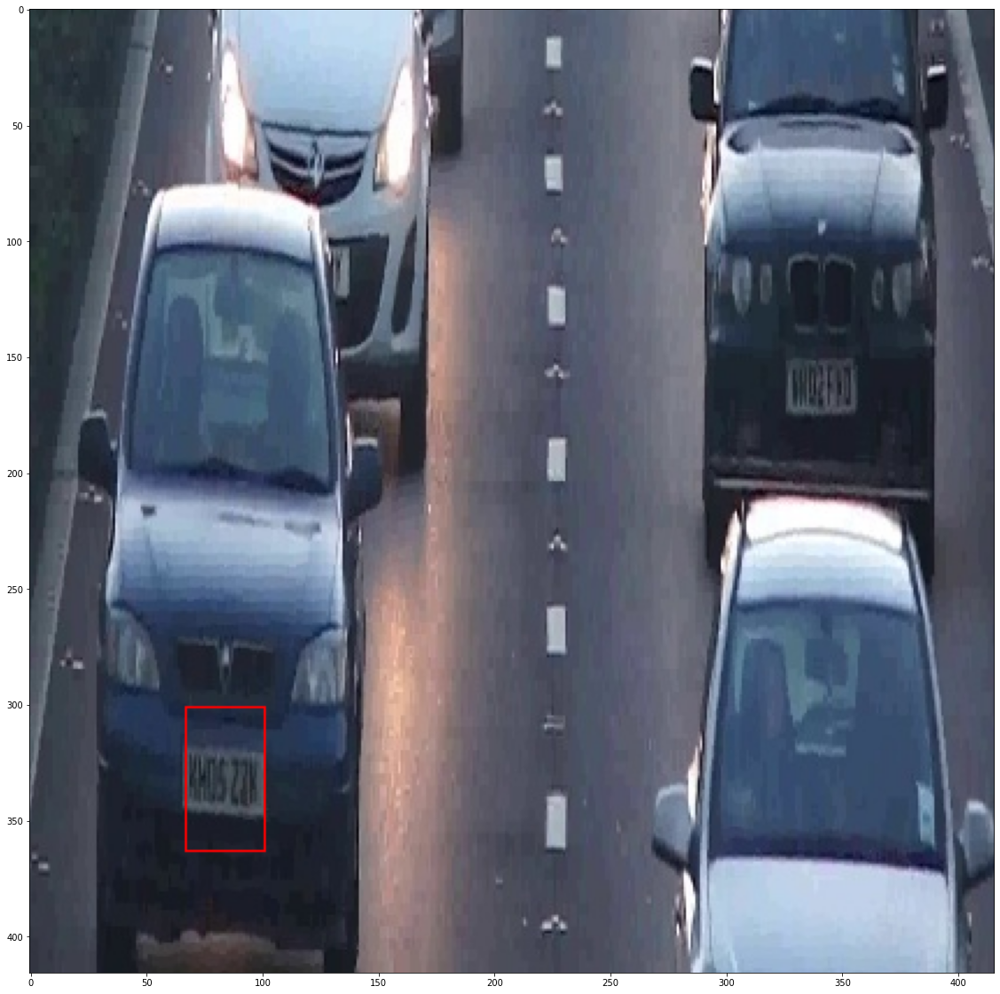

In [17]:
img = cv.imread('cropped/image33_cropped_resized.jpeg')
box = sample_model_run(img)
dim = box[0][0]
cv.rectangle(img, (dim[0],dim[1]), (dim[0]+dim[2],dim[1]+dim[3]), (0,0,255), 1)
plt.figure(figsize = (100,20))
plt.imshow(cv.cvtColor(img, cv.COLOR_BGR2RGB)) 

True

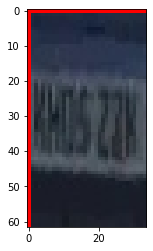

In [18]:
lp1 = img[dim[1]:dim[1]+dim[3],dim[0]:dim[0]+dim[2]]
plt.imshow(cv.cvtColor(lp1, cv.COLOR_BGR2RGB))
cv.imwrite("cropped/image33_lp1.jpeg", lp1)

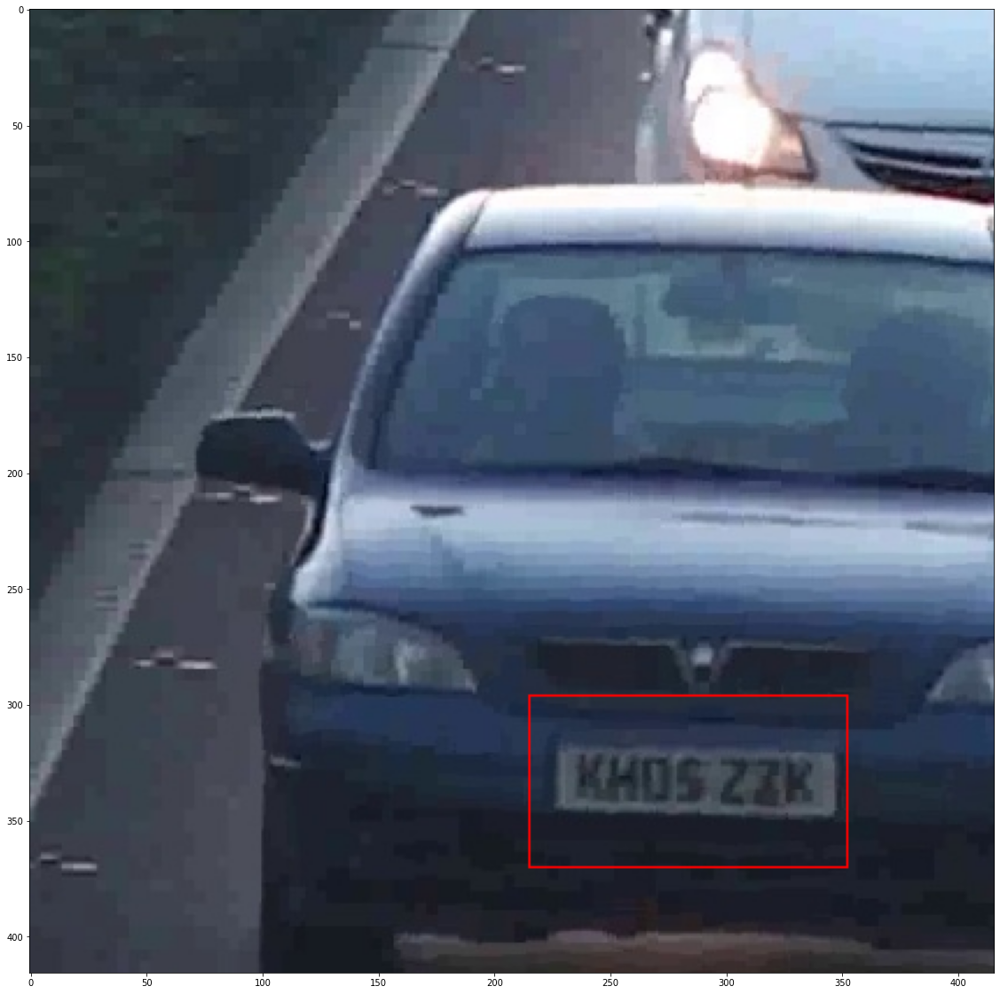

In [19]:
img = cv.imread('cropped/image33_cropped_resized2.jpeg')
box = sample_model_run(img)
dim = box[0][0]
cv.rectangle(img, (dim[0],dim[1]), (dim[0]+dim[2],dim[1]+dim[3]), (0,0,255), 1)
plt.figure(figsize = (100,20))
plt.imshow(cv.cvtColor(img, cv.COLOR_BGR2RGB)) 

True

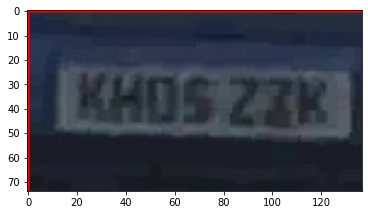

In [20]:
lp2 = img[dim[1]:dim[1]+dim[3],dim[0]:dim[0]+dim[2]]
plt.imshow(cv.cvtColor(lp2, cv.COLOR_BGR2RGB))
cv.imwrite("cropped/image33_lp2.jpeg", lp2)

Above is an interesting depiction that shows if we cropped the left lane itself we don't lose anything with object detection. Notice how in the previous image we did not detect the right lane. Now we will try to take the cropped and resized image of the right lane to see if we get that plate detected

True

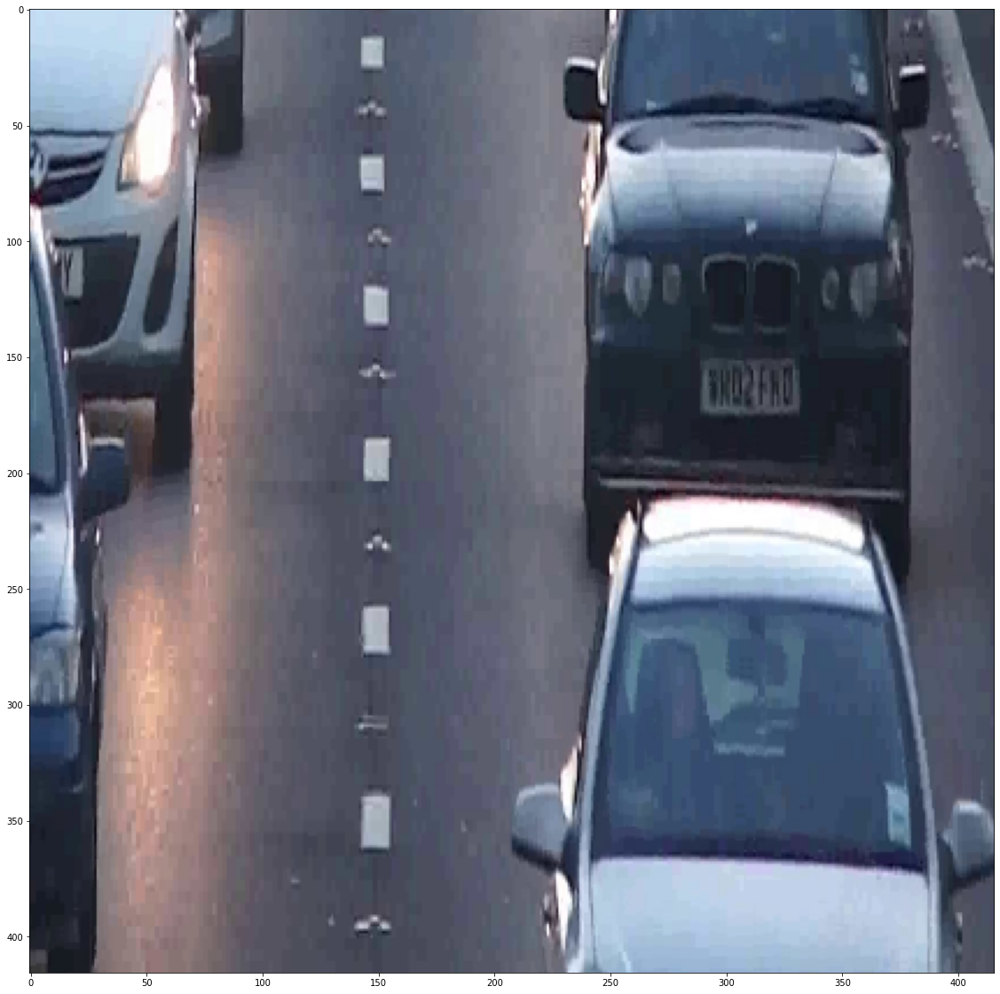

In [21]:
cropped_image6 = original_img2[1500:3000, 1300:3000]
resized_img6 = cv.resize(cropped_image6, (416, 416)) 
plt.figure(figsize = (100,20))
plt.imshow(cv.cvtColor(resized_img6, cv.COLOR_BGR2RGB)) 
cv.imwrite("cropped/image33_cropped_resized2.jpeg", resized_img6)

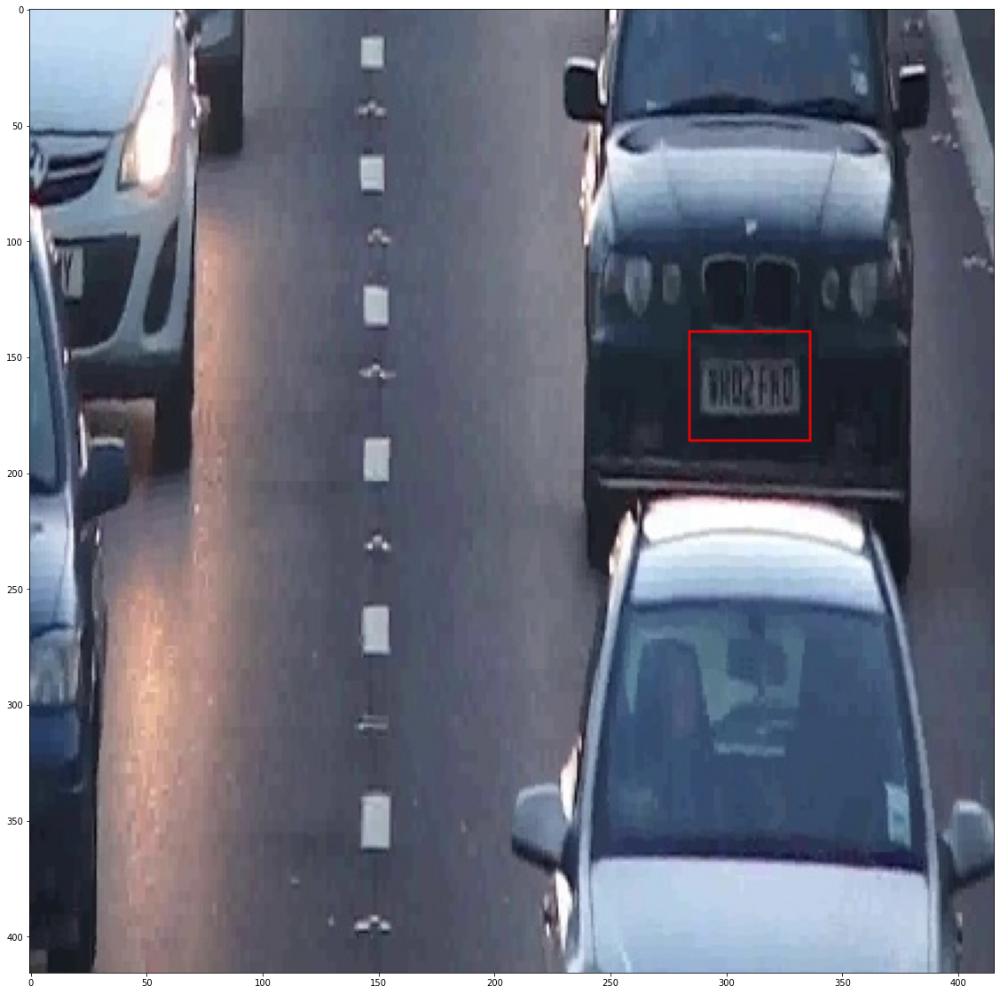

In [22]:
img = cv.imread('cropped/image33_cropped_resized3.jpeg')
box = sample_model_run(img)
dim = box[0][0]
cv.rectangle(img, (dim[0],dim[1]), (dim[0]+dim[2],dim[1]+dim[3]), (0,0,255), 1)
plt.figure(figsize = (100,20))
plt.imshow(cv.cvtColor(img, cv.COLOR_BGR2RGB)) 

Voila! So by splitting it into 2 lanes we can get the bounding boxes for both vehicles. Let's complete for the left side now with remaining images to see if we get the bounding boxes alright

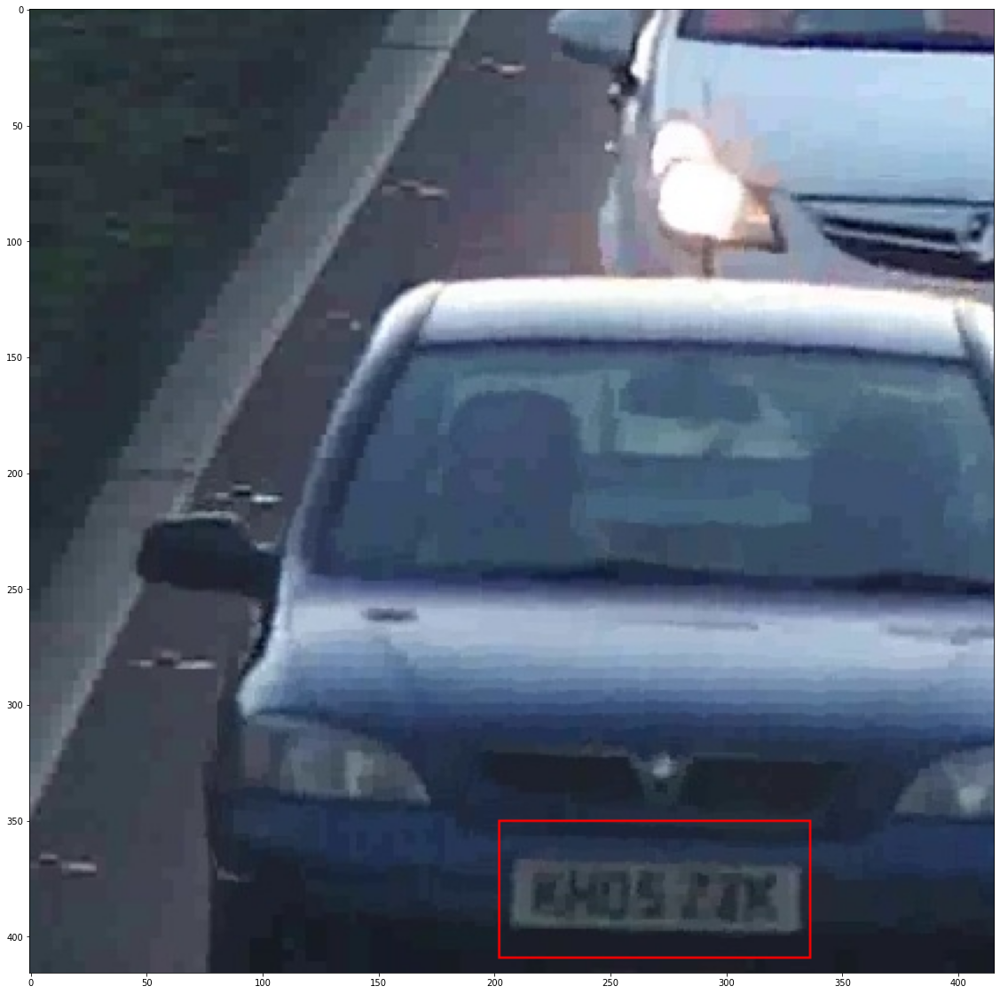

In [23]:
img = cv.imread('cropped/image49_cropped_resized.jpeg')
box = sample_model_run(img)
dim = box[0][0]
cv.rectangle(img, (dim[0],dim[1]), (dim[0]+dim[2],dim[1]+dim[3]), (0,0,255), 1)
plt.figure(figsize = (100,20))
plt.imshow(cv.cvtColor(img, cv.COLOR_BGR2RGB)) 

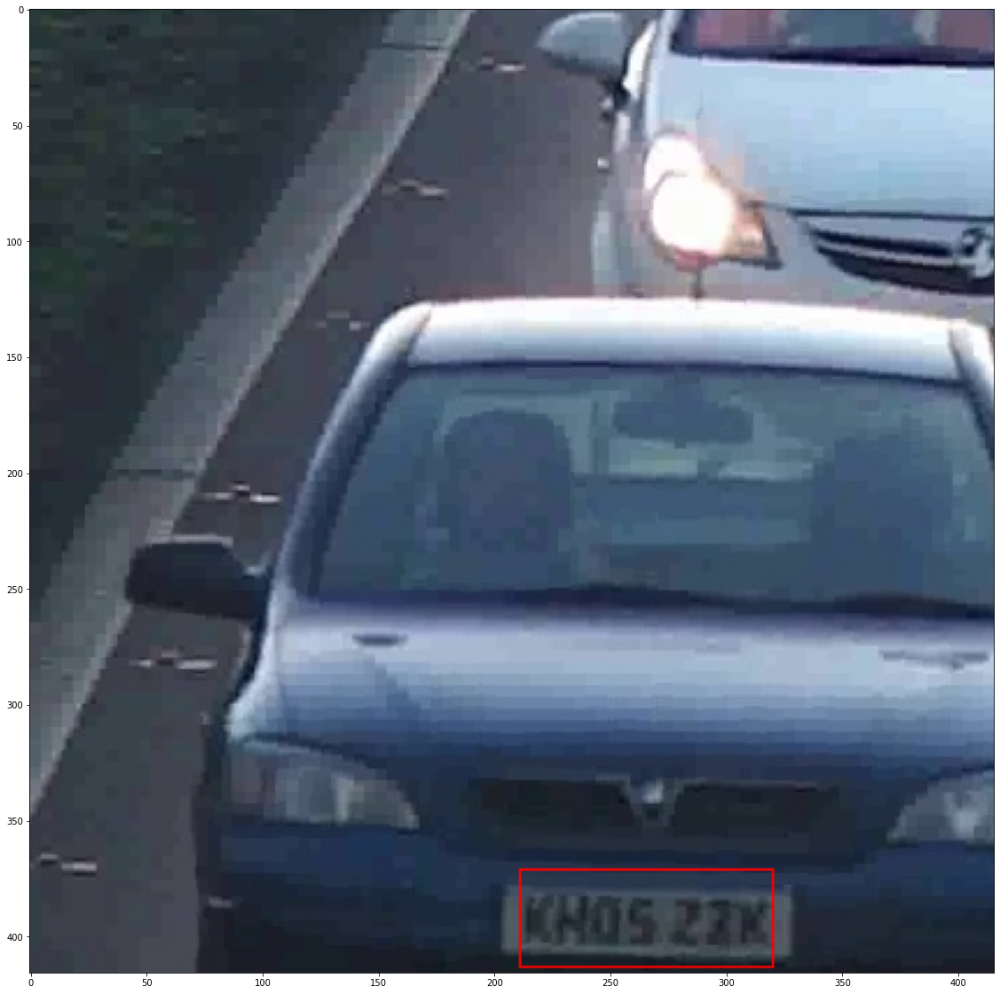

In [24]:
img = cv.imread('cropped/image53_cropped_resized.jpeg')
box = sample_model_run(img)
dim = box[0][0]
cv.rectangle(img, (dim[0],dim[1]), (dim[0]+dim[2],dim[1]+dim[3]), (0,0,255), 1)
plt.figure(figsize = (100,20))
plt.imshow(cv.cvtColor(img, cv.COLOR_BGR2RGB)) 

We will now see how OCR detection works on these images to see how the license plate detection works. For this we need to crop just the license plate images from the bounding boxes

In [25]:
import pytesseract
import re

def detect_licence_plate(img_path):    
    # Read the image
    img_cv = cv.imread(img_path)

    # NOT USING THIS Resize the image slighty to see if it covers slightly misoriented values
    img_resized = cv.resize(img_cv, None, fx = 2, fy = 2,  interpolation = cv.INTER_CUBIC)

    # Convert to grayscale
    img_gray = cv.cvtColor(img_resized, cv.COLOR_BGR2GRAY)
    
    # Apply dilation to reduce noise
    kernel = np.ones((1, 1), np.uint8)
    img_gray = cv.dilate(img_gray, kernel, iterations=1)
    img_gray = cv.erode(img_gray, kernel, iterations=1)
    
    # Blur and Filter
    cv.threshold(cv.medianBlur(img_gray, 3), 0, 255, cv.THRESH_BINARY + cv.THRESH_OTSU)[1]
    cv.adaptiveThreshold(cv.bilateralFilter(img_gray, 9, 75, 75), 255, cv.ADAPTIVE_THRESH_GAUSSIAN_C, cv.THRESH_BINARY, 31, 2)

    # Predict using OCR
    prediction = pytesseract.image_to_string(img_gray, lang ='eng', config ='--oem 3 --psm 6 ')
    
    # Remove everything outside of alphanumeric characters
    license_plate_no = re.sub(r'[^A-Z0-9-]+', '', prediction)
    
    # License plates are also meant to be between 6 and 8 characters
    if (len(license_plate_no)<6 or len(license_plate_no)<6):
        return ''
    
    return license_plate_no 

In [26]:
lp_no33_1 = detect_licence_plate(img_path = 'cropped/image33_lp1.jpeg')
print(lp_no33_1)
lp_no33_2 = detect_licence_plate(img_path = 'cropped/image33_lp2.jpeg')
print(lp_no33_2)

From the above it is clear that the OCR is not doing a good job of detection

True

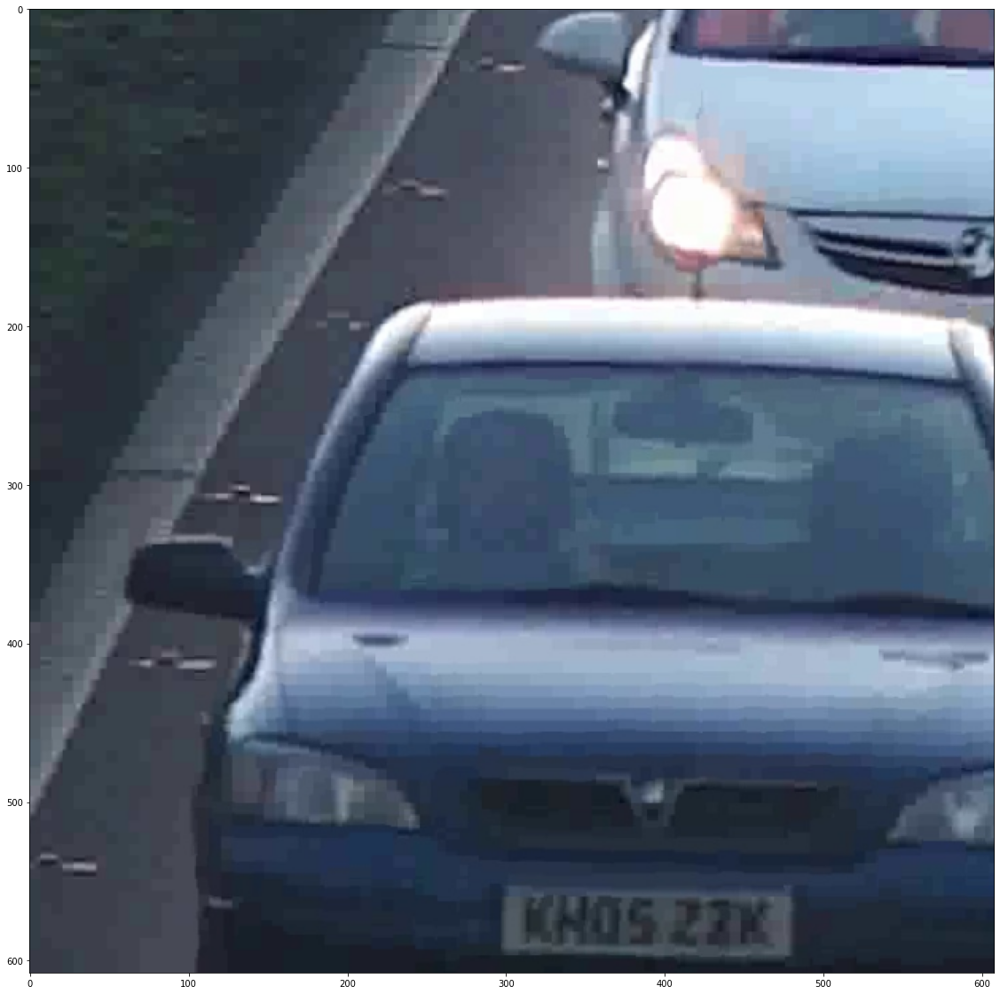

In [27]:
resized_img_high = cv.resize(cropped_image5, (608, 608)) 
plt.figure(figsize = (100,20))
plt.imshow(cv.cvtColor(resized_img_high, cv.COLOR_BGR2RGB)) 
cv.imwrite("cropped/image53_resized_608.jpeg", resized_img_high)

In [28]:
def modified_model_run(cv_img):
    # Initialize Neural Network - note I am not committing the weights
    net = cv.dnn.readNet('lpr-yolov3.weights', 'lpr-yolov3.cfg')
    layer_name = net.getLayerNames()
    output_layer = [layer_name[i - 1] for i in net.getUnconnectedOutLayers()]
    
    blob = cv.dnn.blobFromImage(cv_img, 1/255 , (608, 608), True, False)  

    # Detect objects
    net.setInput(blob)
    outs = net.forward(output_layer)

    # Initialize arrays for class ids (object class ids), confidence for each and box values to print in the image
    class_ids = []
    confidences = []
    boxes = []
    for out in outs:
        for detection in out:
            scores = detection[5:]
            class_id = np.argmax(scores)
            confidence = scores[class_id]

            # Object detection
            if confidence > 0.1:
                center_x = int(detection[0] * 608)
                center_y = int(detection[1] * 608)
                w = int(detection[2] * 608)
                h = int(detection[3] * 608)

                # Reactangle Coordinate
                x = int(center_x - w/2)
                y = int(center_y - h/2)

                # Populate boxes
                boxes.append([x, y, w, h])
                confidences.append(float(confidence))
                class_ids.append(class_id)

    # Remove overlapping boxes
    indexes = cv.dnn.NMSBoxes(boxes, confidences, 0.5, 0.4)

    # Create dictionary of class label and associated confidence
    box_detection_confidence = []

    # Run through the range and populate the dictionary
    for i in range(len(boxes)):
        if i in indexes:
            box_detection_confidence.append(tuple((boxes[i], confidences[i]*100)))
            
    return box_detection_confidence

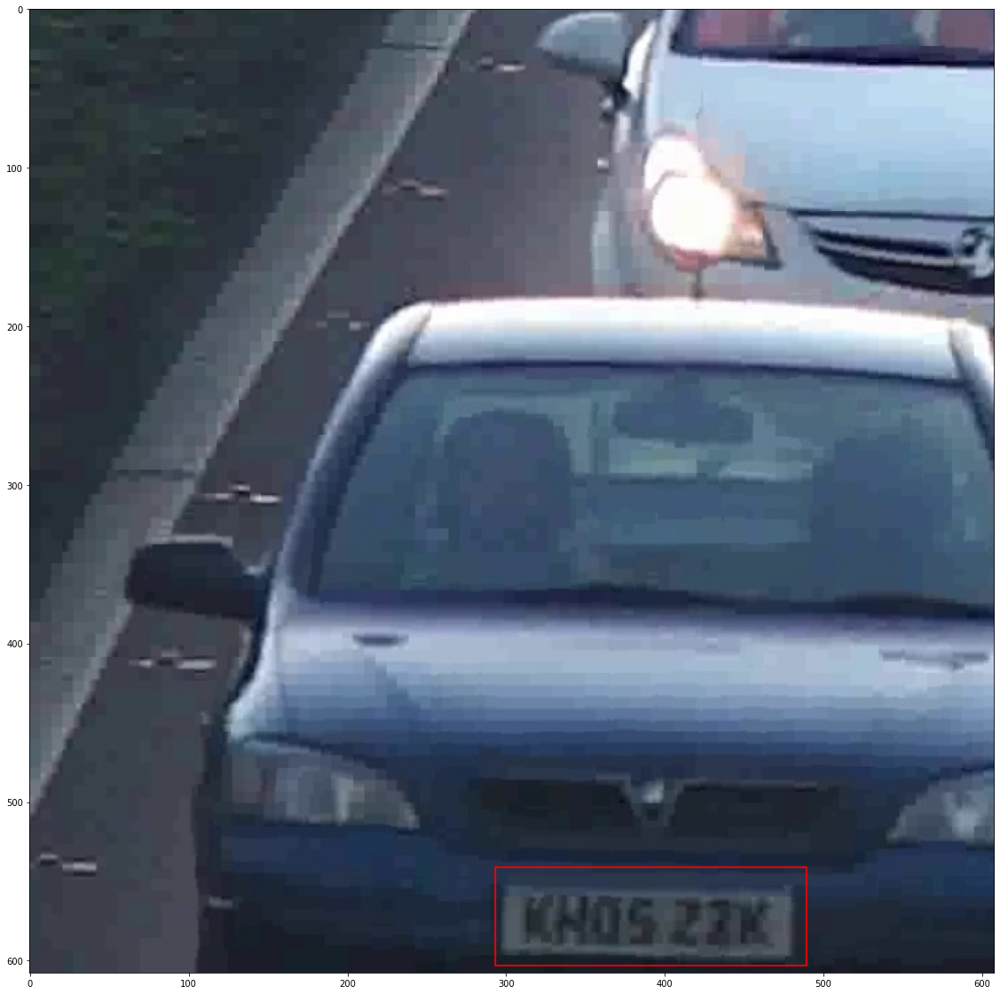

In [29]:
img = cv.imread('cropped/image53_resized_608.jpeg')
box = modified_model_run(img)
dim = box[0][0]
cv.rectangle(img, (dim[0],dim[1]), (dim[0]+dim[2],dim[1]+dim[3]), (0,0,255), 1)
plt.figure(figsize = (100,20))
plt.imshow(cv.cvtColor(img, cv.COLOR_BGR2RGB)) 

True

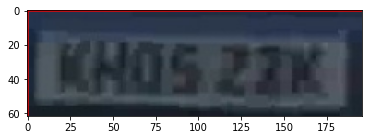

In [30]:
img53_lp3 = img[dim[1]:dim[1]+dim[3],dim[0]:dim[0]+dim[2]]
plt.imshow(cv.cvtColor(img53_lp3, cv.COLOR_BGR2RGB))
cv.imwrite("cropped/image53_lp1.jpeg", img53_lp3)

In [31]:
lp_no53_1 = detect_licence_plate(img_path = 'cropped/image53_lp1.jpeg')
print(lp_no53_1)

In [32]:
img_org = cv.imread('original/image53.jpeg')
cropped_img = img_org[1500:3000, 600:1300]
resized_img_high = cv.resize(cropped_img, (608, 608)) 
cv.imwrite("cropped/image53_resized_608_2.jpeg", resized_img_high)
img = cv.imread('cropped/image53_resized_608_2.jpeg')
box = modified_model_run(img)
dim = box[0][0]
img53_lp4 = img[dim[1]:dim[1]+dim[3],dim[0]:dim[0]+dim[2]]
cv.imwrite("cropped/image53_lp4.jpeg", img53_lp4)
lp_no53_4 = detect_licence_plate(img_path = 'cropped/image53_lp4.jpeg')
print(lp_no53_4)

KMOS22K


In [35]:
resized_img2_high = cv.resize(cropped_image2, (608, 608)) 
cv.imwrite("cropped/image33_resized_608.jpeg", resized_img2_high)
img = cv.imread('cropped/image33_resized_608.jpeg')
box = modified_model_run(img)
dim = box[0][0]
img33_lp3 = img[dim[1]:dim[1]+dim[3],dim[0]:dim[0]+dim[2]]
cv.imwrite("cropped/image33_lp3.jpeg", img33_lp3)
lp_no33_3 = detect_licence_plate(img_path = 'cropped/image33_lp3.jpeg')
print(lp_no33_3)

We can see this is better than when we were using 416 x 416. So let's try running this through the other sets of files. We can do this by running through all the images in the <b>original</b> folder 

In [34]:
import os

# assign directory
directory = 'original'
 
# Loop through the directory
i = 1
lp_predictions = list()
bounding_box_width = list()
bounding_box_height = list()

for filename in os.listdir(directory):
    # Go through all the files and create path
    f = os.path.join(directory, filename)
    
    # Read the image
    img_org = cv.imread(f)

    # Crop the image
    cropped_img = img_org[1500:3000, 600:1300]

    if (cropped_img is not None):
        resized_img_high = cv.resize(cropped_img, (608, 608)) 
        box = modified_model_run(resized_img_high)

        if (len(box))>=1:
            dim = box[0][0]
            
            # Add the width and height to the list for us to calculate statistics
            bounding_box_width.append(dim[2])
            bounding_box_height.append(dim[3])
            
            lp_img = img[dim[1]:dim[1]+dim[3],dim[0]:dim[0]+dim[2]]
            lp_img_nm = "lp/lp" + str(i) + ".jpeg"
            cv.imwrite(lp_img_nm, lp_img)
            lp = detect_licence_plate(img_path = lp_img_nm)
            
            if (len(lp)>=1):
                lp_predictions.append(lp)
    i = i + 1

print(lp_predictions)

['KOS22K', 'KMDS22K', 'KMOS72K', 'KHOS22K', 'KMOS22', 'KHOSZK', 'KMOSZK', 'KHOS22K', 'KHOS22K']


We have tried a few different parameters with the OCR with Tesseract as shown below

<ol>
    <li>
        <b>oem:</b> This can have values 1-3 and with the above example we get the best outputs with the value of 3
    </li>
    <li>
        <b>psm:</b> This can have values from 1-12 and I got the best results with either 6 or 8. So I am going to go with 6
    </li>
    <li>
        <b>grayscaling:</b> Converting the image to gray scale had an impact on the accuracy so went with it
    </li>
</ol>

<b>Note:</b> Performance of these parameters was measured in terms of getting 100% accuracy on atleast 1 image, number of times the accurate prediction was reached and how far off the other predictions were. We can see from the above, that we get different predictions from different images for the same vehicle. So we need to pick the best one based on some metric. 

During hyper parameter tuning for OCR we can use a distance metric such as Levenshtein as shown below. 

In [39]:
from Levenshtein import distance as lev

# Initialize minimal levenstine distance 
min_lev = 10
lp_best = ''
lev_distances = list()
for lp_pred in lp_predictions:
    # Obtain Levinshtein Distance
    lev_dist = lev(lp_pred, 'KH0S22K')
    lev_distances.append(lev_dist)
    
    # Check with minimum
    if (lev_dist < min_lev):
        min_lev = lev_dist
        lp_best = lp_pred

# Get the best prediction
print(lp_predictions)
print(lev_distances)
print(lp_best)

['KOS22K', 'KMDS22K', 'KMOS72K', 'KHOS22K', 'KMOS22', 'KHOSZK', 'KMOSZK', 'KHOS22K', 'KHOS22K']
[2, 2, 3, 1, 3, 3, 4, 1, 1]
KHOS22K


For actual predictions we need something that will give us the most confidence. Assuming we have enough images with clarity we can use the max frequence to determine the best prediction as in this example where with the Tuning of OCR and using this strategy we are able to get <b>KHOS22K</b> as the correct prediction

In [40]:
lp_unique, lp_frequency = np.unique(np.array(lp_predictions), return_counts = True) 
print(lp_unique)
print(lp_frequency)

lp_best = lp_unique[np.argmax(lp_frequency)]
print(lp_best)

['KHOS22K' 'KHOSZK' 'KMDS22K' 'KMOS22' 'KMOS72K' 'KMOSZK' 'KOS22K']
[3 1 1 1 1 1 1]
KHOS22K


In [42]:
print(np.mean(np.array(bounding_box_width)))
print(np.mean(np.array(bounding_box_height)))
print(np.std(np.array(bounding_box_width)))
print(np.std(np.array(bounding_box_height)))

197.8709677419355
66.41935483870968
22.835656803431792
6.524268311705287


### Conclusions

Through this data analysis we can conclude the following

<ul>
    <li>
        <b>Pre-processing:</b> The Yolo model does well in identifying the license plate objects especially <i>when we split the images into left and right lanes</i>. <b>Cropping & resizing</b>  also assist here in zeroing down the actual image that corresponds to only the license plate
    </li>
    <li>
        <b>Bounding Boxes:</b> The Yolo model produces bounding boxes of <b>Average Width:197</b> and <b>Average Height:66</b>. Note the high std deviation for width and this is likely due to how the dimensions change as objects come in closer
    </li>
    <li>
        <b>Typical Locations for Bounding Boxes:</b> The typical locations are bottom left and bottom right which is typical of when cars approach within a certain window where detection is possible and the plates are not hidden by the car in front
    </li>
    <li>
        <b>Multiple Images for Same Licence Plate:</b> Given the nature of the video streams we have several images for the same license plate. E.g. going through the 512 images generated from the video frames of LicensePlateReaderSample_4K.mov show that there actually just 5 vehicles and 4 of them have the license plates KHOS22K, FJ14ZHY, AVD9HVF, NA54KGJ with the 5th one that cannot be read easily. In other words we get multiple opportunities to detect the license plate
    </li>
</ul>

The above will influence the design in following ways 

<ul>
    <li>
        <b>Asynchronous Processing via Message Based Systems:</b>The requirements have said the following: The system must be capable of capturing images of moving vehicles at toll booths and accurately recognizing and recording their license plates. The recognized license plates will then be used to automatically charge the tolls to the vehicles’ registered owners, thus requiring the system to have a high accuracy to ensure correct billing and customer satisfaction.<b>Nowhere it is stated on the turnaround time for the billing</b>. Wha is important is accurate billing. This implies that we can process the data asnychronously, improve its accuracy and get the list of license plates detected correctly
    </li>
    <li>
        <b>Lane Splitting:</b>Splitting the image into 2 one for the left and right lane enables us to get bounding boxes for both lanes. 
    </li>
    <li>
        <b>Pre-processing:</b>Cropping the image, resizing it to 608 x 608 enables us to use the highest resolution from YOLO stand point
    </li>
    <li>
        <b>Use of multiple images for Accuracy:</b>We are required to produce a set of license plates for vehicles that have passed the tolls. In other words, not every image is important. What we need is from a set of images to derive the potential license plates. So the system will process all images from a video stream and derive the list of license plates. If the actual set maches exactly the list of plates then the accuracy is 100%. If the system misses to obtain some plates those would be False Positives. If the system identifies plates that do not exist, those are false negatives
    </li>
    <li>
        <b>License Plate Detection:</b>For actual license number detection, we will apply some optimizations to Tesseract OCR such as using gray scale, applying blur, reduce noise, etc which improves the accuracy. We will also ignore any character other than alphanumeric and also look for predictions that 6-8 in length so we discard bad predictions. Ultimately the prediction with max occurences would be picked
    </li>
</ul>


In [ ]:
img = cv.imread('/workspace/shared-data/license-plates/alpr-images/original/image330.jpeg')
cropped_img = img[1500:3000, 600:1400]
resized_img_high = cv.resize(cropped_img, (608, 608)) 
box = modified_model_run(resized_img_high)
dim = box[0][0]
cv.rectangle(resized_img_high, (dim[0],dim[1]), (dim[0]+dim[2],dim[1]+dim[3]), (0,0,255), 1)
plt.figure(figsize = (100,20))
plt.imshow(cv.cvtColor(resized_img_high, cv.COLOR_BGR2RGB)) 
img330_lp1 = resized_img_high[dim[1]:dim[1]+dim[3],dim[0]:dim[0]+dim[2]]
cv.imwrite("cropped/img330_lp1.jpeg", img330_lp1)
lp = detect_licence_plate(img_path = "cropped/img330_lp1.jpeg")
print(lp)

In [ ]:
# assign directory
directory = '/workspace/shared-data/license-plates/alpr-images/original'
 
# Loop through the directory
i = 1
lp_predictions = list()
bounding_box_width = list()
bounding_box_height = list()

for filename in os.listdir(directory):
    # Go through all the files and create path
    f = os.path.join(directory, filename)
    
    # Read the image
    img_org = cv.imread(f)

    # Crop the image
    cropped_img = img_org[1500:3000, 600:1300]

    if (cropped_img is not None):
        resized_img_high = cv.resize(cropped_img, (608, 608)) 
        box = modified_model_run(resized_img_high)

        # Add the width and height to the list for us to calculate statistics
        bounding_box_width.append(dim[2])
        bounding_box_height.append(dim[2])
        
        if (len(box))>=1:
            dim = box[0][0]
            lp_img = img[dim[1]:dim[1]+dim[3],dim[0]:dim[0]+dim[2]]
            lp_img_nm = "lp/lp" + str(i) + ".jpeg"
            cv.imwrite(lp_img_nm, lp_img)
            lp = detect_licence_plate(img_path = lp_img_nm)
            
            if (len(lp)>=1):
                lp_predictions.append(lp)
    i = i + 1

print(lp_predictions)

lp_unique, lp_frequency = np.unique(np.array(lp_predictions), return_counts = True) 
detected_license_plates = lp_unique[np.argwhere(lp_frequency > 2)]
print(detected_license_plates)